In [2]:
import torch
import torchaudio
import torchaudio.functional as F
import torchaudio.transforms as T

In [29]:
from IPython.display import Audio
import os
import librosa
import matplotlib.pyplot as plt
from torchaudio.utils import download_asset
torch.random.manual_seed(0)

def plot_waveform(waveform, sr, title="Waveform"):
    waveform = waveform.numpy()

    num_channels, num_frames = waveform.shape
    print(num_channels)
    time_axis = torch.arange(0, num_frames) / sr
    
    figure, axes = plt.subplots(num_channels, 1)
    for i in range(num_channels):
    
        axes[i].plot(time_axis, waveform[0], linewidth=1)
        axes[i].grid(True)
    figure.suptitle(title)
    plt.show(block=False)


def plot_spectrogram(specgram, title=None, ylabel="freq_bin"):
    fig, axs = plt.subplots(1, 1)
    axs.set_title(title or "Spectrogram (db)")
    axs.set_ylabel(ylabel)
    axs.set_xlabel("frame")
    im = axs.imshow(librosa.power_to_db(specgram), origin="lower", aspect="auto")
    fig.colorbar(im, ax=axs)
    plt.show(block=False)


def plot_fbank(fbank, title=None):
    fig, axs = plt.subplots(1, 1)
    axs.set_title(title or "Filter bank")
    axs.imshow(fbank, aspect="auto")
    axs.set_ylabel("frequency bin")
    axs.set_xlabel("mel bin")
    plt.show(block=False)

In [30]:
from pytube import YouTube

yt = YouTube("https://www.youtube.com/watch?v=QGh3NNKu9eQ")
  
# extract only audio
video = yt.streams.filter(only_audio=True).first()
  
# check for destination to save file
print("Enter the destination (leave blank for current directory)")
destination = "downloads"
  
# download the file
out_file = video.download(output_path=destination)
  
# save the file
base, ext = os.path.splitext(out_file)
new_file = base + '.m4a'
os.rename(out_file, new_file)
  
# result of success
print(yt.title + " has been successfully downloaded.")



Enter the destination (leave blank for current directory)
Sampha - Plastic 100°C (Official Audio) has been successfully downloaded.


In [39]:
#load wavform and sample_rate100
waveform100, sample_rate100 = torchaudio.load(new_file)

#metadata
print(torchaudio.info(new_file))

#playable
Audio(waveform100.numpy()[0], rate=sample_rate100)

AudioMetaData(sample_rate=44100, num_frames=1666, num_channels=2, bits_per_sample=0, encoding=AAC)


In [40]:
n_fft = 1024
win_length = None
hop_length = 512

# Define transform
spectrogram = T.Spectrogram(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    pad_mode="reflect",
    power=2.0,
)

In [41]:
spec = spectrogram(waveform100)

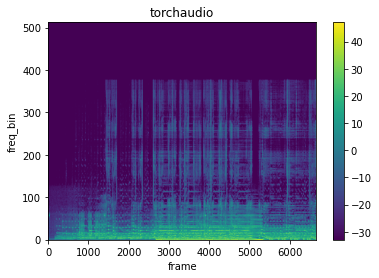

In [42]:
plot_spectrogram(spec[0], title="torchaudio")

In [43]:
torch.random.manual_seed(0)

n_fft = 1024
win_length = None
hop_length = 512

spec = T.Spectrogram(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
)(waveform100)

In [44]:
griffin_lim = T.GriffinLim(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
)

In [45]:
reconstructed_waveform = griffin_lim(spec)

2


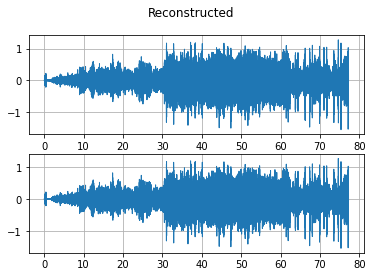

In [46]:
plot_waveform(reconstructed_waveform, sample_rate100, title="Reconstructed")
Audio(reconstructed_waveform, rate=sample_rate100)